In [1]:
import os
import sys
starter_path = os.path.abspath(os.getcwd())
sys.path.insert(0, starter_path)

In [2]:
from final.ReID_Baseline_Cosine import ReidModel1 as baseline_cosine
from final.ReID_Slice_Alt_Augmented import SliceNet as slice_alt
from final.ReID_Slice_Alt_Cosine_Augmented import SliceNet as slice_alt_cosine
from final.ReID_Slice_Cosine import SliceNet as slice_cosine
from final.ReID_Slice_old import SliceNet as slice_model

In [3]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import pandas as pd

In [4]:
from torch.nn import Conv2d,Linear, Module, Sequential,BatchNorm2d,MaxPool2d
import torch.nn.functional as F

In [5]:
inv_normalize_gallery = transforms.Normalize(
    mean=[-0.4726/0.2765, -0.4468/0.2747, -0.4811/0.2764],
    std=[1/0.2765, 1/0.2747, 1/0.2764]
)
inv_normalize_query = transforms.Normalize(
    mean=[-0.4726/0.2765, -0.4468/0.2747, -0.4811/0.2764],
    std=[1/0.2765, 1/0.2747, 1/0.2764]
)

In [6]:
def get_gallery_image(i):
  return inv_normalize_gallery(image_datasets['gallery'].__getitem__(i)[0]).permute(1,2,0)
def get_query_image(i):
  return inv_normalize_query(image_datasets['query'].__getitem__(i)[0]).permute(1,2,0)

In [7]:
from matplotlib.pyplot import figure, imshow, axis, title
from matplotlib.image import imread
def showImagesHorizontally(list_of_images,labels):
    fig = figure(figsize=(8,30))
    number_of_files = len(list_of_images)
    for i in range(number_of_files):
        a=fig.add_subplot(1,number_of_files,i+1)
        image = list_of_images[i]
        image = torch.clamp(image,min=0,max=1)
        imshow(image)
        if i>0:
            title(str(labels[i-1]))
        axis('off')

In [8]:
# Evaluation 
# Acknowledgement: the code is based on Siddhant Kapil's repo on LA-Transformer

from __future__ import print_function

import os, sys
import faiss
import numpy as np

from PIL import Image
from tqdm.notebook import tqdm

import torch
import torch.nn as nn
from torch.nn import init
import torch.optim as optim
from torchvision import models
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset

from model import ReidModel, DummyModel
from utils import get_id
from metrics import rank1, rank5, calc_ap

batch_size = 1
H, W, D = 1, 1, 128 # for dummymodel we have feature volume 7x7x2048
transform_query_list = [
        transforms.Resize((128,48), interpolation=3),
        transforms.ToTensor(),
        transforms.Normalize([0.4726, 0.4468, 0.4811], [0.2765, 0.2747, 0.2764])
    ]
transform_gallery_list = [
        transforms.Resize(size=(128,48), interpolation=3), #Image.BICUBIC
        transforms.ToTensor(),
        transforms.Normalize([0.4726, 0.4468, 0.4811], [0.2765, 0.2747, 0.2764])
    ]

data_transforms = {
        'query': transforms.Compose( transform_query_list ),
        'gallery': transforms.Compose(transform_gallery_list),
    }


image_datasets = {}
data_dir = starter_path+"/data/val"

image_datasets['query'] = datasets.ImageFolder(os.path.join(data_dir, 'query'),
                                        data_transforms['query'])
image_datasets['gallery'] = datasets.ImageFolder(os.path.join(data_dir, 'gallery'),
                                        data_transforms['gallery'])

query_loader = DataLoader(dataset = image_datasets['query'], batch_size=batch_size, shuffle=False )
gallery_loader = DataLoader(dataset = image_datasets['gallery'], batch_size=batch_size, shuffle=False)

class_names = image_datasets['query'].classes
def evaluate(ReidModel,weights_file):
  # ### Set feature volume sizes (height, width, depth) 
  # TODO: update with your model's feature length


  # ### Load Model

  # TODO: Uncomment the following lines to load the Implemented and trained Model

  model = ReidModel(numClasses = 62, inference=True)
  model.load_state_dict(torch.load(weights_file,map_location=torch.device('cpu')), strict=False)
  model.eval()

  # TODO: Comment out the dummy model
  # model = DummyModel(batch_size, H, W, D)

  # ### Data Loader for query and gallery

  # TODO: For demo, we have resized to 224x224 during data augmentation
  # You are free to use augmentations of your own choice


  # ###  Extract Features

  def extract_feature(dataloaders):
      
      features =  torch.FloatTensor()
      count = 0
      idx = 0
      for data in tqdm(dataloaders):
          img, label = data
          # print(label)
          # Uncomment if using GPU for inference
          #img, label = img.cuda(), label.cuda()

          output = model(img) # (B, D, H, W) --> B: batch size, HxWxD: feature volume size
          n, c, h, w = img.size()
          
          count += n
          features = torch.cat((features, output.detach().cpu()), 0)
          idx += 1
      return features

  # Extract Query Features

  query_feature= extract_feature(query_loader)

  # Extract Gallery Features

  gallery_feature = extract_feature(gallery_loader)

  # Retrieve labels

  gallery_path = image_datasets['gallery'].imgs
  query_path = image_datasets['query'].imgs

  gallery_cam,gallery_label = get_id(gallery_path)
  query_cam,query_label = get_id(query_path)


  # ## Concat Averaged GELTs
  concatenated_query_vectors = []
  for query in tqdm(query_feature):
      fnorm = torch.norm(query, p=2, dim=0, keepdim=True)#*np.sqrt(H*W)
      query_norm = query.div(fnorm.expand_as(query))
      concatenated_query_vectors.append(query_norm.view((-1)))

  concatenated_gallery_vectors = []
  for gallery in tqdm(gallery_feature):
      fnorm = torch.norm(gallery, p=2, dim=0, keepdim=True)#*np.sqrt(H*W)
      gallery_norm = gallery.div(fnorm.expand_as(gallery))
      concatenated_gallery_vectors.append(gallery_norm.view((-1)))
    

  # ## Calculate Similarity using FAISS

  index = faiss.IndexIDMap(faiss.IndexFlatIP(H*W*D))
  # combine label and index into id
  ids = np.array(gallery_label)*1000+np.arange(len(gallery_label))
  index.add_with_ids(np.array([t.numpy() for t in concatenated_gallery_vectors]),ids)

  def search(query: str, k=1):
      encoded_query = query.unsqueeze(dim=0).numpy()
      top_k = index.search(encoded_query, k)
      return top_k


  # ### Evaluate 

  rank1_score = 0
  rank5_score = 0
  ap = 0
  count = 0
  result_indexes_all = []

  for query, label in zip(concatenated_query_vectors, query_label):
      count += 1
      label = label
      output = search(query, k=10)
      # get indices
      result_indexes_all.append([len(result_indexes_all),output[1]])
      # get labels
      output = (output[0],output[1]//1000)
      rank1_score += rank1(label, output) 
      rank5_score += rank5(label, output) 
      print("Correct: {}, Total: {}, Incorrect: {}".format(rank1_score, count, count-rank1_score), end="\r")
      ap += calc_ap(label, output)

  print("Rank1: %.3f, Rank5: %.3f, mAP: %.3f"%(rank1_score/len(query_feature), 
                                              rank5_score/len(query_feature), 
                                              ap/len(query_feature)))
  for i,p in enumerate(result_indexes_all):
    q,r=p
    print(i+1)
    indices = (r%1000).flatten()
    labels = (r//1000).flatten()
    showImagesHorizontally([get_query_image(q)]+list(map(get_gallery_image,indices)),labels)
    plt.show()

/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:287: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/181 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/181 [00:00<?, ?it/s]

Rank1: 0.964, Rank5: 1.000, mAP: 0.953
1


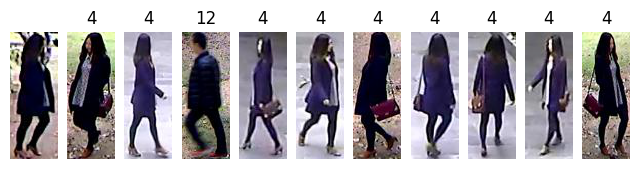

2


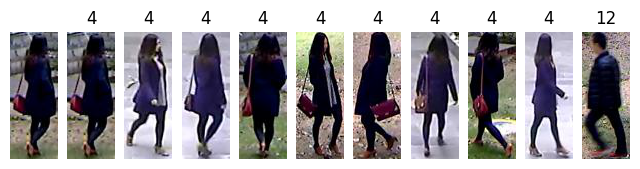

3


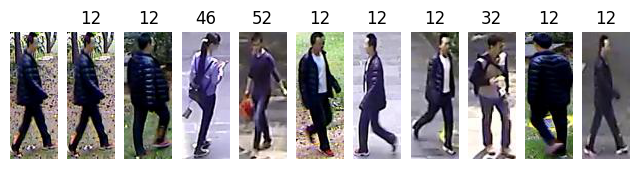

4


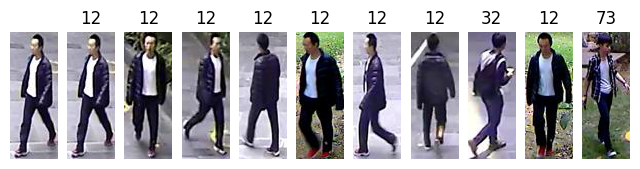

5


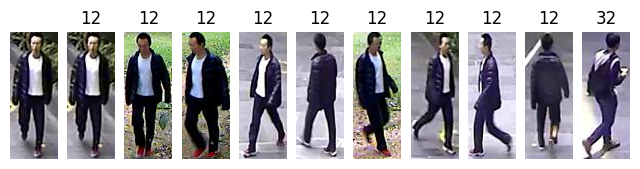

6


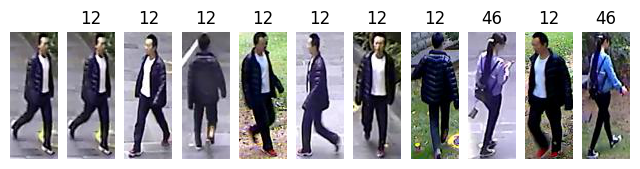

7


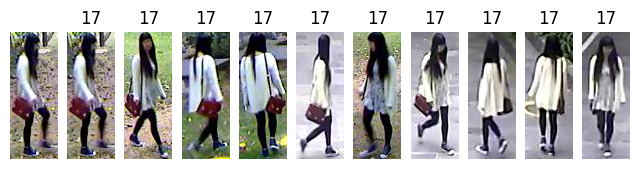

8


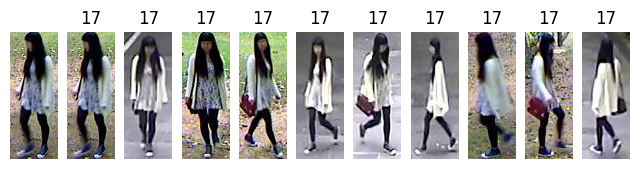

9


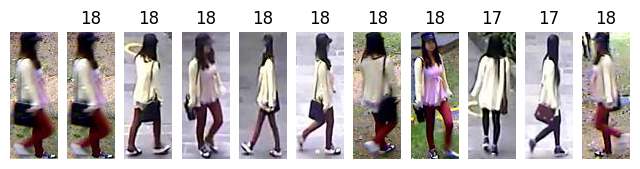

10


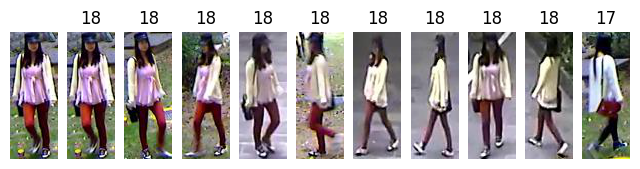

11


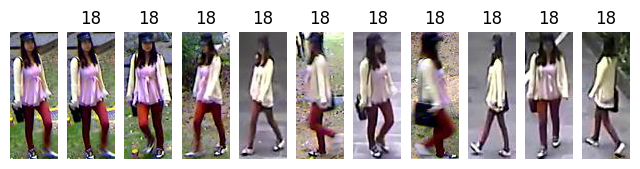

12


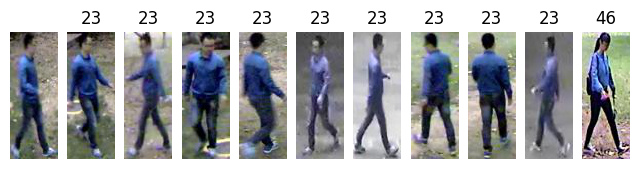

13


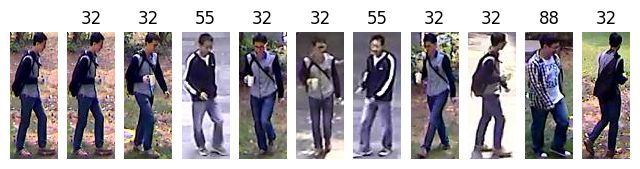

14


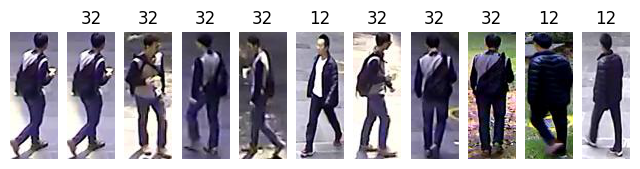

15


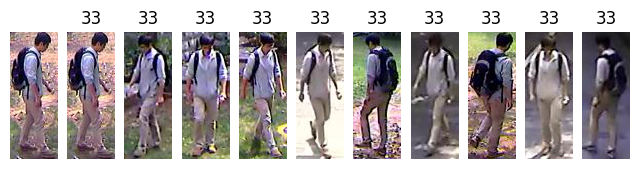

16


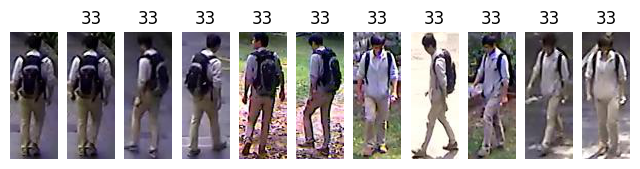

17


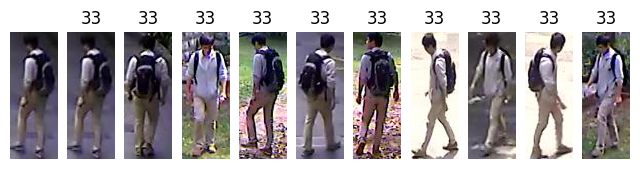

18


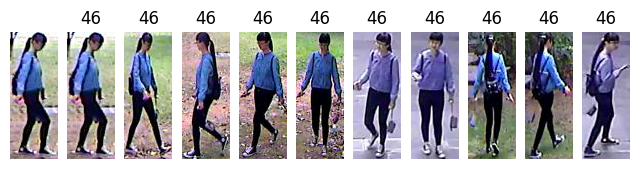

19


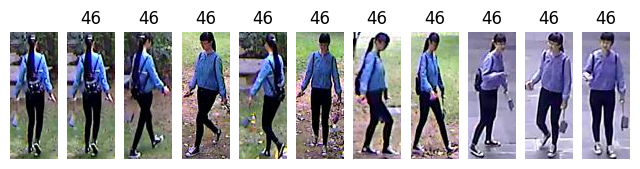

20


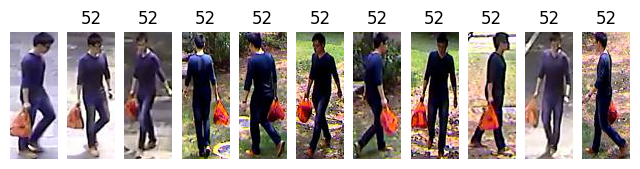

21


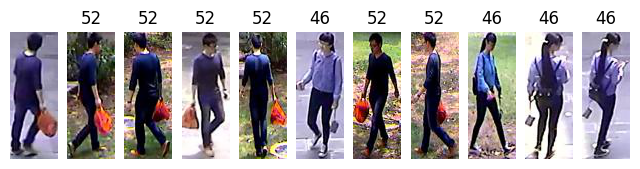

22


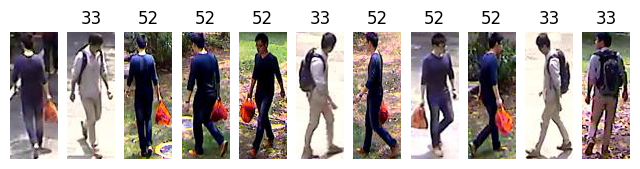

23


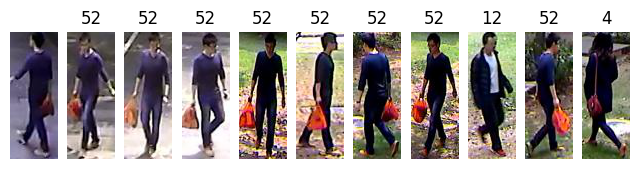

24


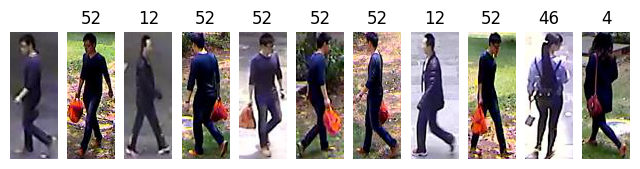

25


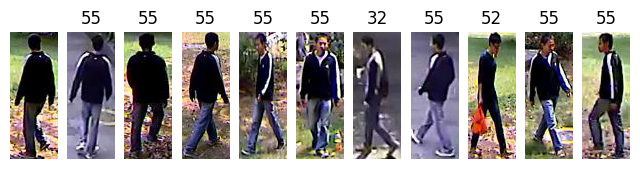

26


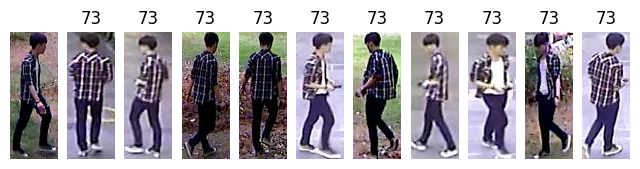

27


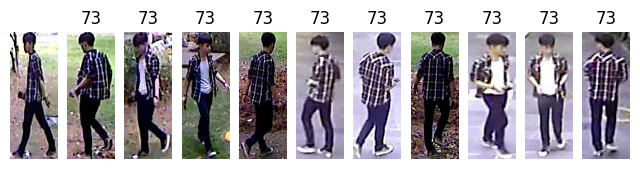

28


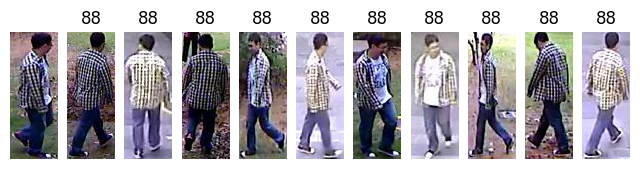

In [9]:
evaluate(slice_alt_cosine,"final/models/final_model_alt_cosine_augmented_125.pth")

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/181 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/181 [00:00<?, ?it/s]

Rank1: 0.857, Rank5: 1.000, mAP: 0.878
1


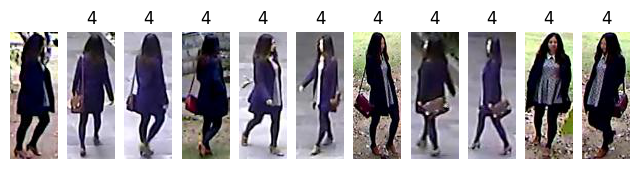

2


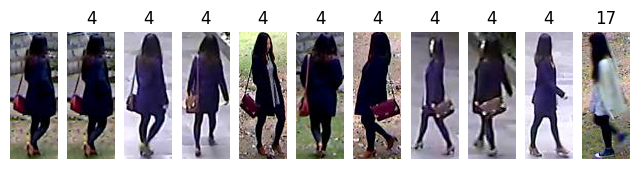

3


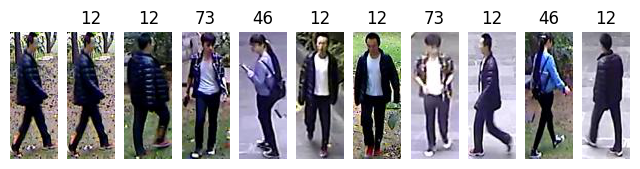

4


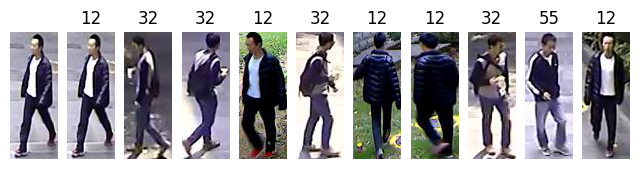

5


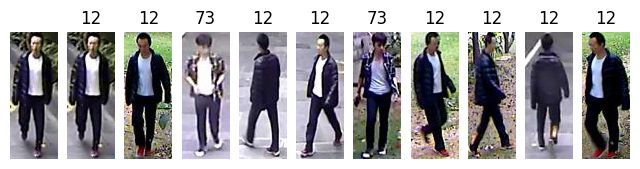

6


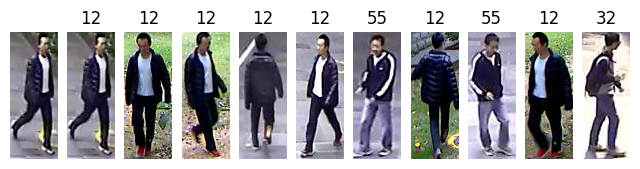

7


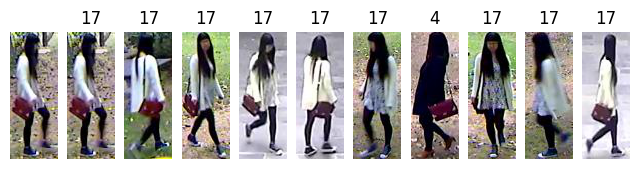

8


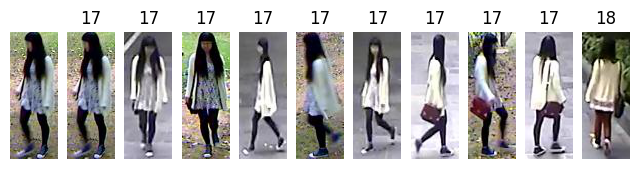

9


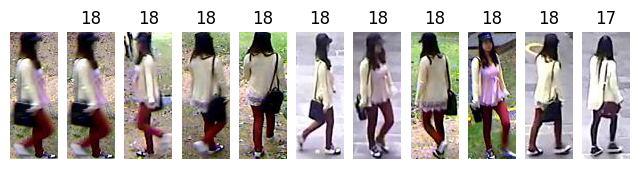

10


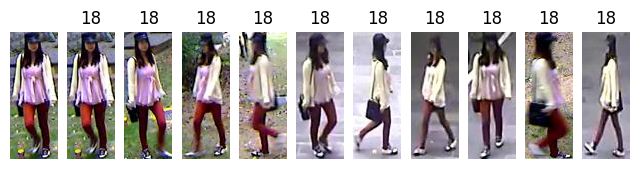

11


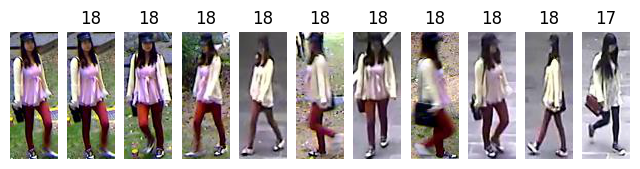

12


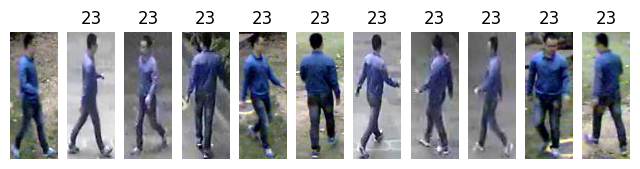

13


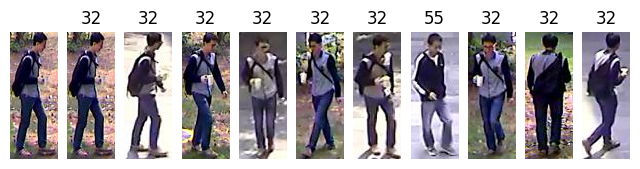

14


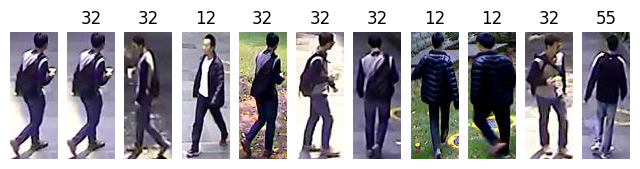

15


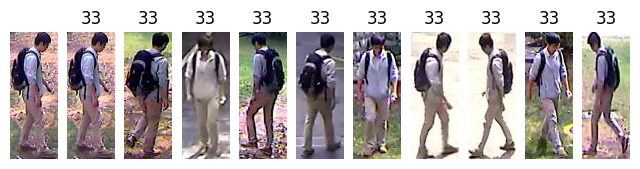

16


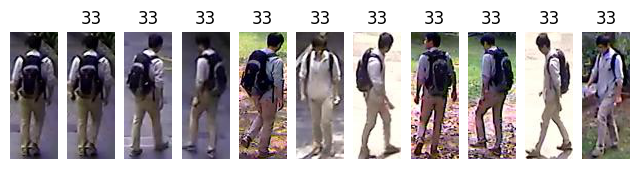

17


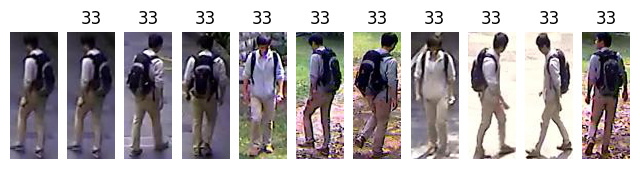

18


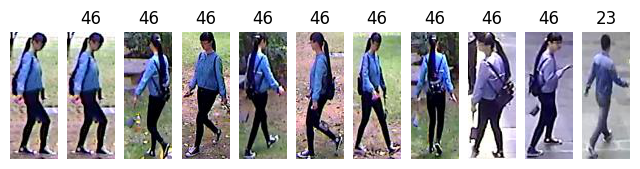

19


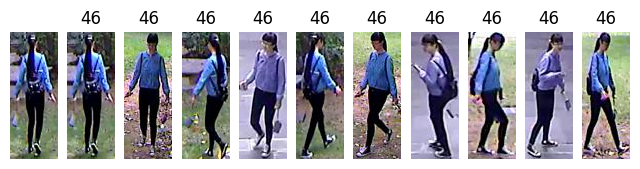

20


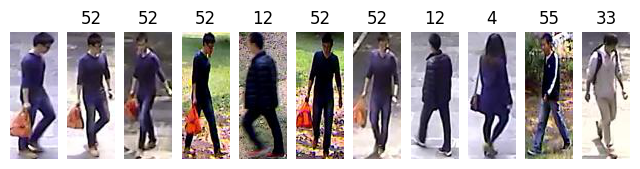

21


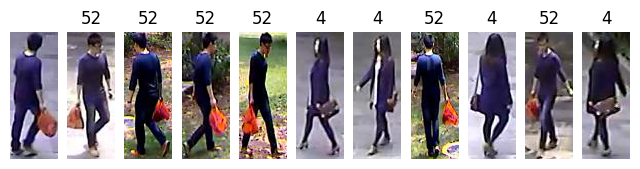

22


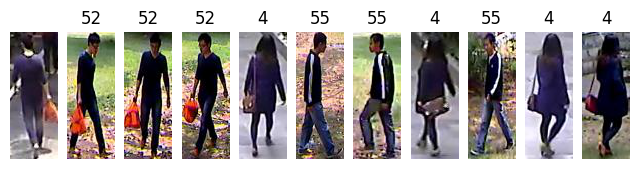

23


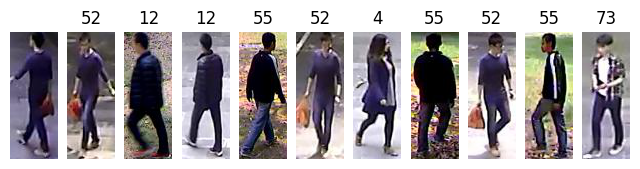

24


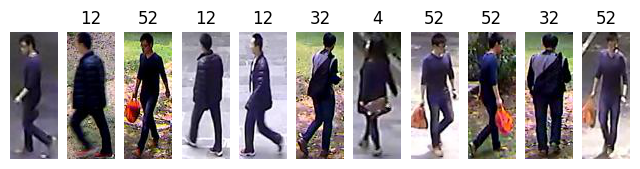

25


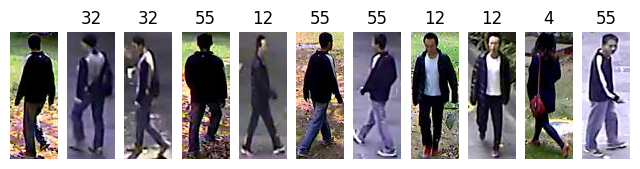

26


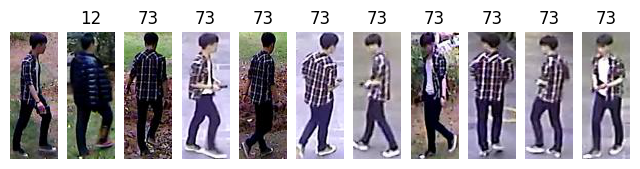

27


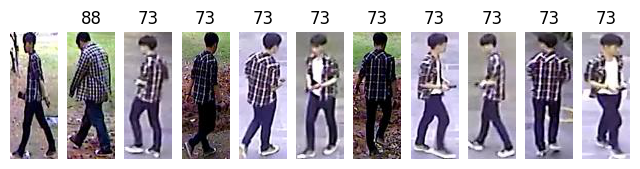

28


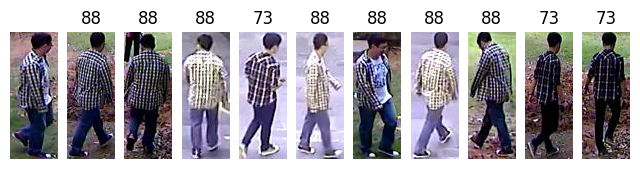

In [10]:
evaluate(baseline_cosine,"final/models/final_model_baseline_cosine_augmented_100.pth")

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/181 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/181 [00:00<?, ?it/s]

Rank1: 0.964, Rank5: 1.000, mAP: 0.951
1


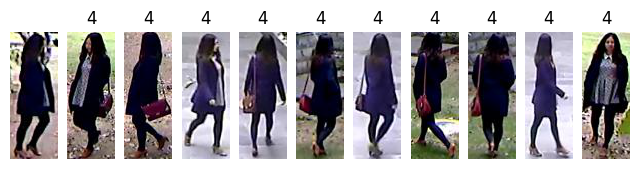

2


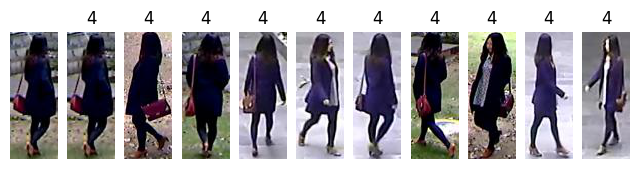

3


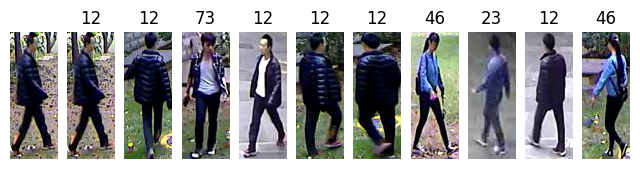

4


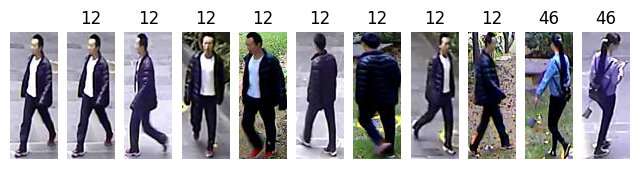

5


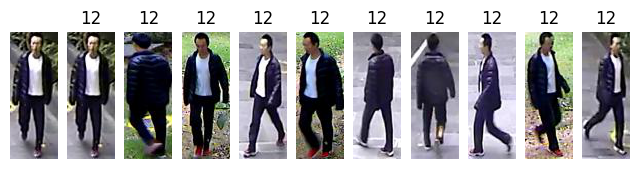

6


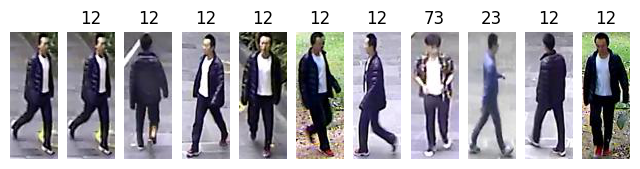

7


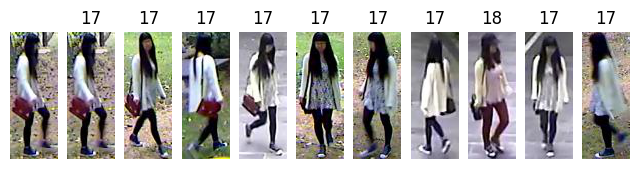

8


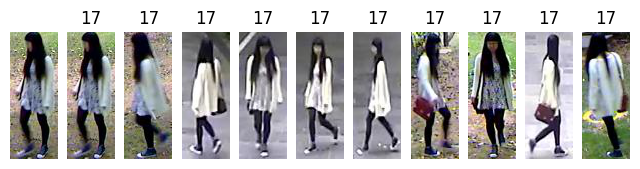

9


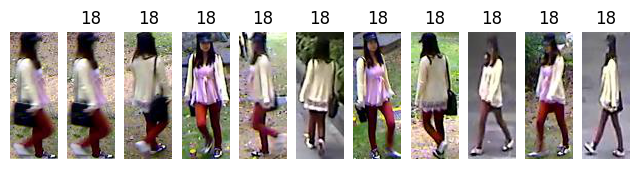

10


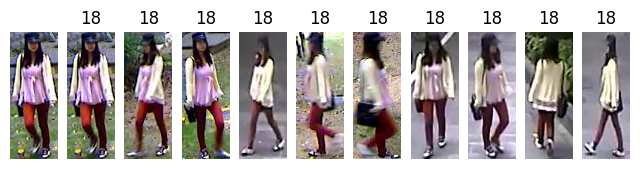

11


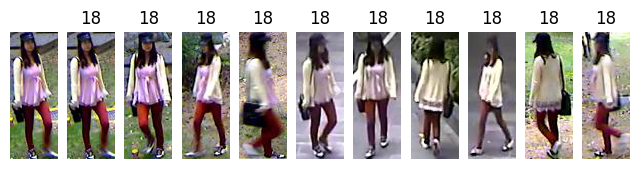

12


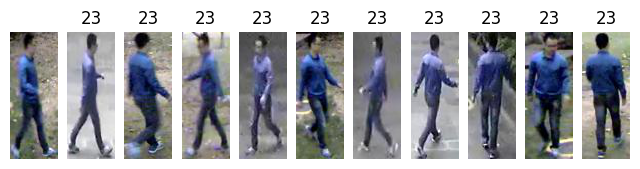

13


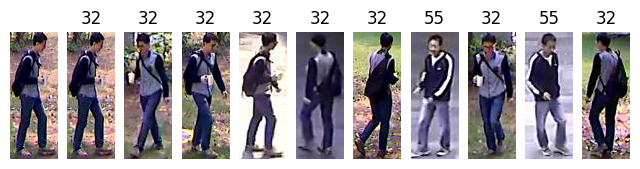

14


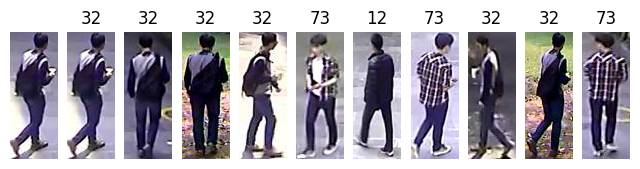

15


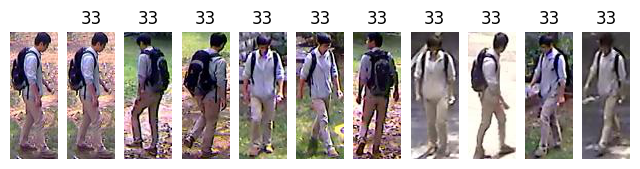

16


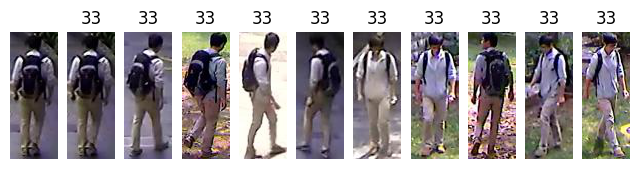

17


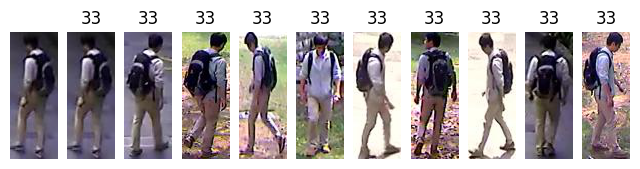

18


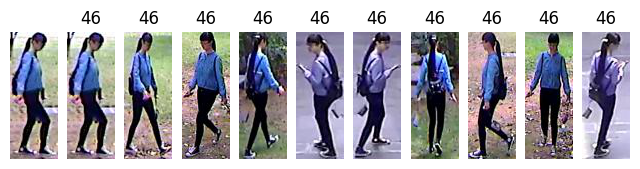

19


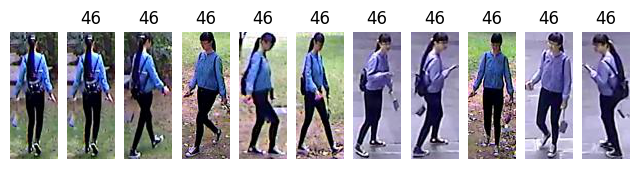

20


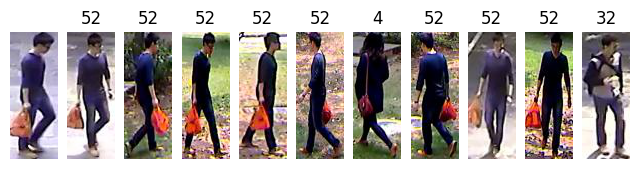

21


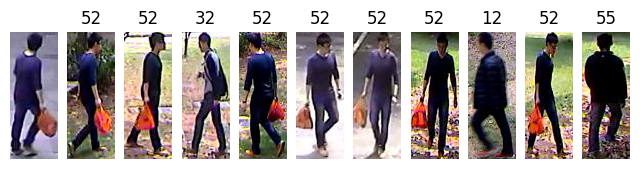

22


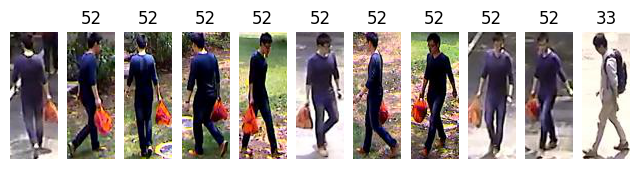

23


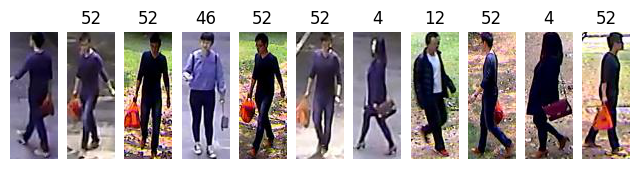

24


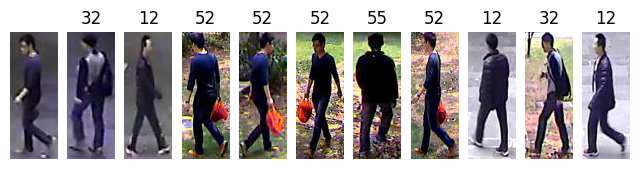

25


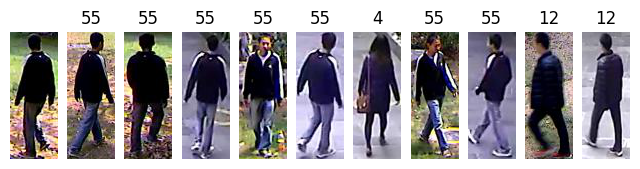

26


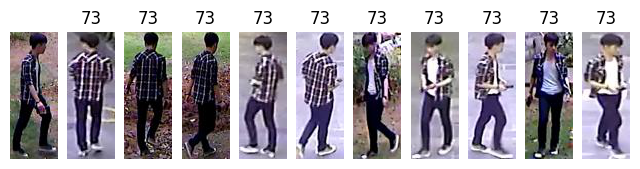

27


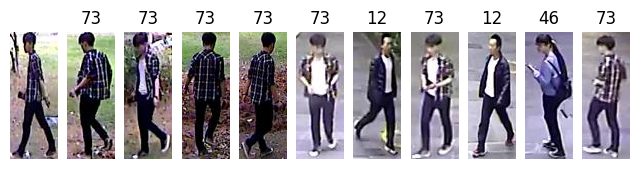

28


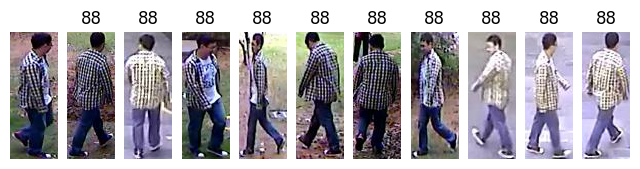

In [11]:
evaluate(slice_cosine,"final/models/final_model_Slice_Cosine_100.pth")

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/181 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/181 [00:00<?, ?it/s]

Rank1: 0.929, Rank5: 1.000, mAP: 0.861
1


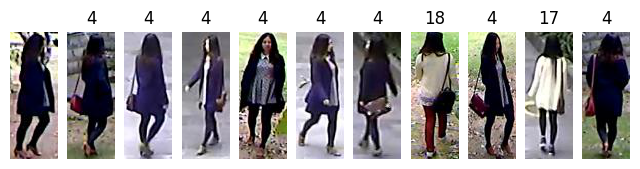

2


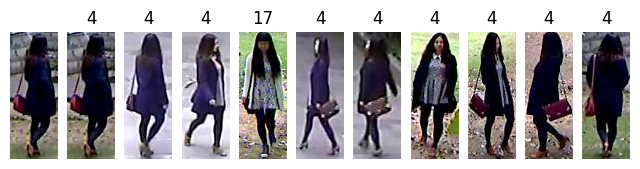

3


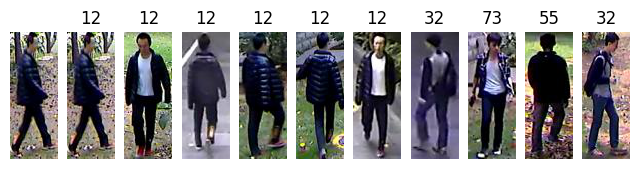

4


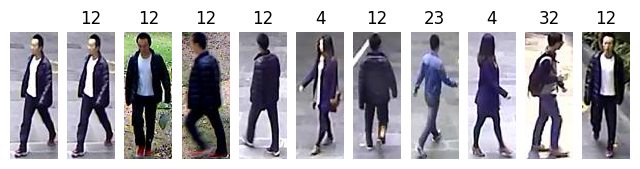

5


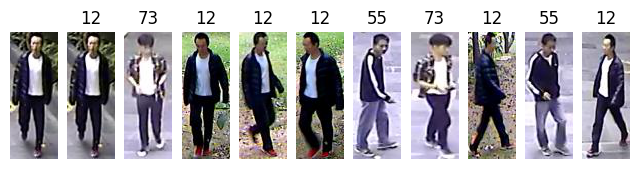

6


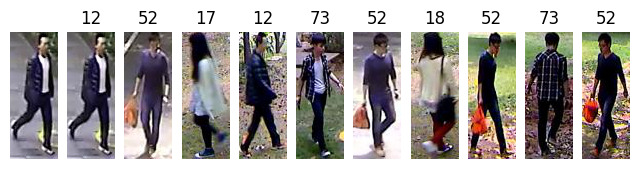

7


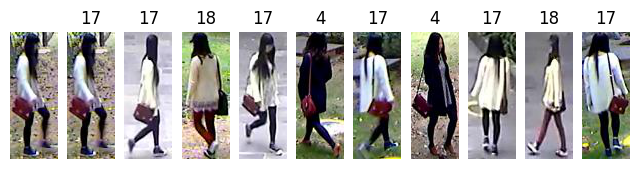

8


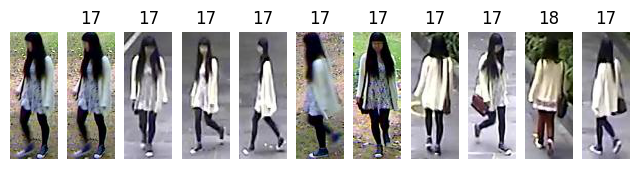

9


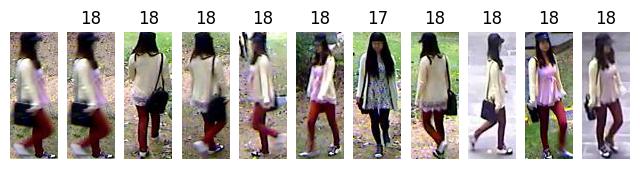

10


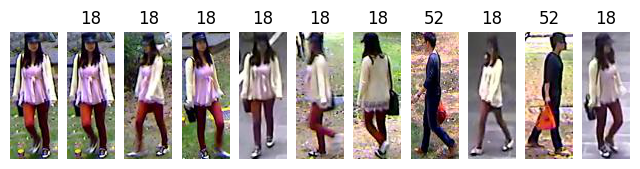

11


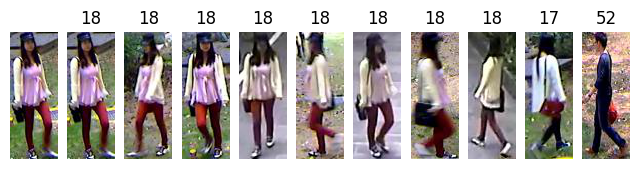

12


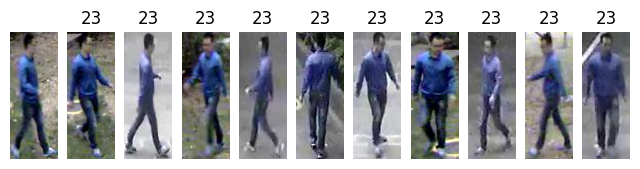

13


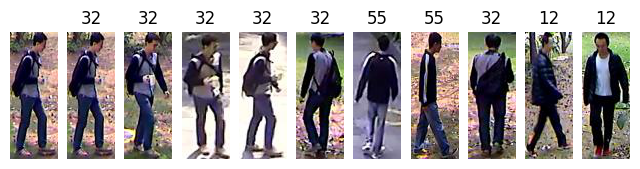

14


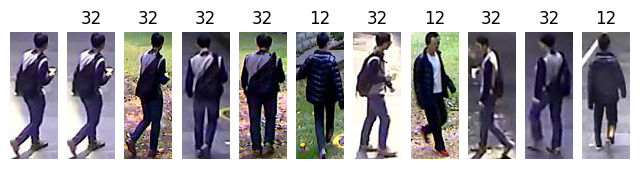

15


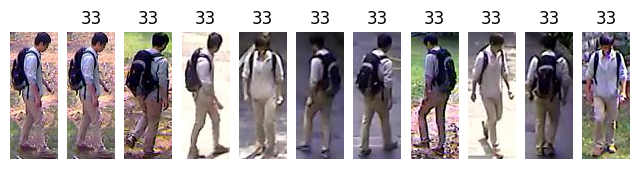

16


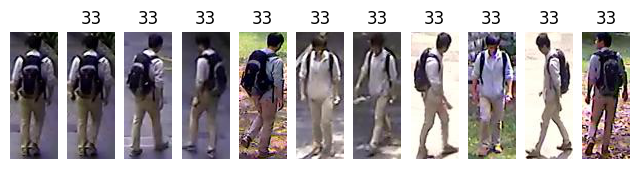

17


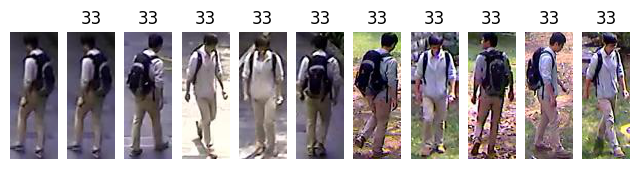

18


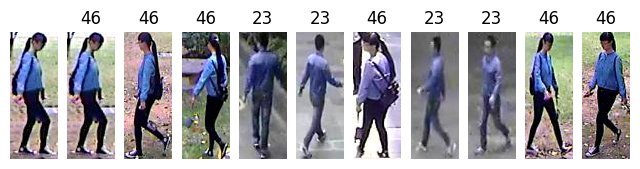

19


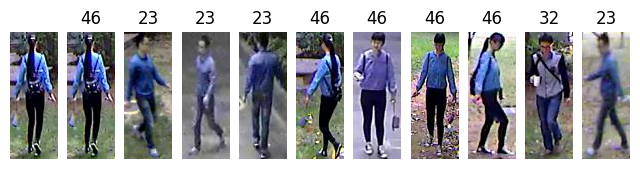

20


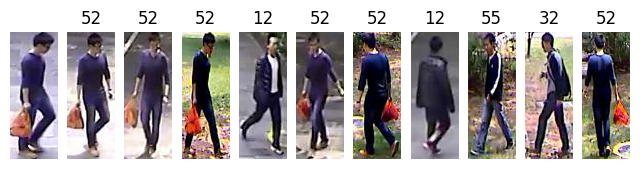

21


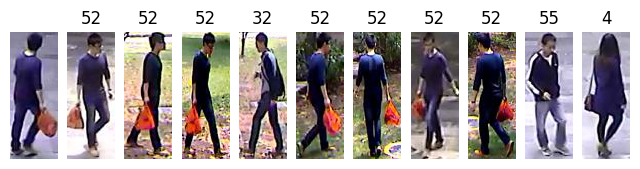

22


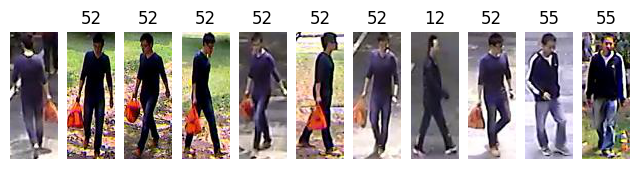

23


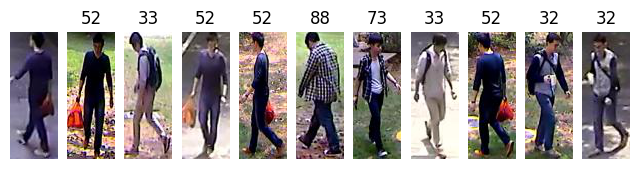

24


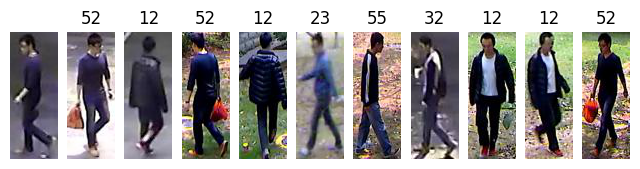

25


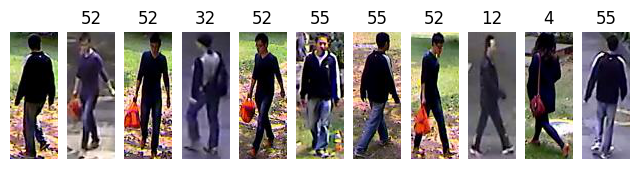

26


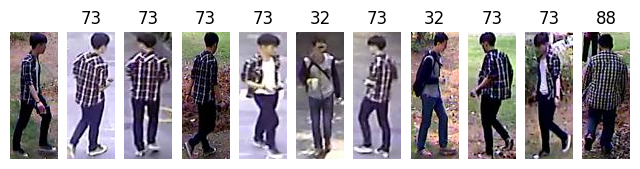

27


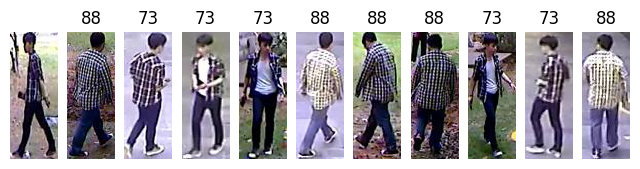

28


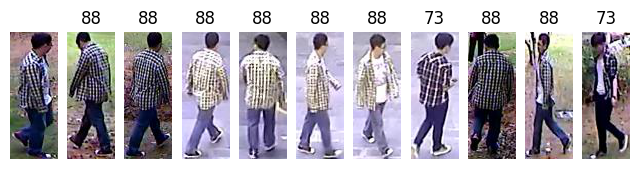

In [12]:
evaluate(baseline_cosine,"final/models/final_model_baseline_cosine_no_augmentation_150.pth")